In [28]:
import numpy as np
from numpy import genfromtxt
import csv
import pandas as pd


# arr = np.genfromtxt("all weights year plurality race.csv", delimiter = ",",dtype = str)
# print(arr)

# df = pd.read_csv("all weights year plurality race.csv")
# df


In [29]:
import geopandas

lwdf = pd.read_csv("Datasets/lowweight_by_race.csv")
lwdf

path_to_data = geopandas.datasets.get_path("nybb")
gdf = geopandas.read_file(path_to_data)

gdf

race_df = pd.merge(gdf,lwdf, on='BoroCode')
race_df



,BoroCode,BoroName_x,Shape_Leng,Shape_Area,geometry,BoroName_y,Year,race,hispanic origin,total births,500-2500g births,percentage
0,5,Staten Island,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227....","Richmond County, NY",2016,Asian,Hispanic or Latino,82,0,0.000000
1,5,Staten Island,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227....","Richmond County, NY",2016,Asian,Not Hispanic or Latino,492,23,0.000000
2,5,Staten Island,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227....","Richmond County, NY",2016,Black or African American,Hispanic or Latino,202,15,0.000000
3,5,Staten Island,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227....","Richmond County, NY",2016,Black or African American,Not Hispanic or Latino,579,61,0.039724
4,5,Staten Island,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227....","Richmond County, NY",2016,White,Hispanic or Latino,860,53,0.016279
...,...,...,...,...,...,...,...,...,...,...,...,...
175,2,Bronx,464392.991824,1.186925e+09,"MULTIPOLYGON (((1012821.806 229228.265, 101278...","Bronx County, NY",2021,Asian,Not Hispanic or Latino,935,101,0.029947
176,2,Bronx,464392.991824,1.186925e+09,"MULTIPOLYGON (((1012821.806 229228.265, 101278...","Bronx County, NY",2021,Black or African American,Hispanic or Latino,3779,293,0.025933
177,2,Bronx,464392.991824,1.186925e+09,"MULTIPOLYGON (((1012821.806 229228.265, 101278...","Bronx County, NY",2021,Black or African American,Not Hispanic or Latino,4310,496,0.043619
178,2,Bronx,464392.991824,1.186925e+09,"MULTIPOLYGON (((1012821.806 229228.265, 101278...","Bronx County, NY",2021,White,Hispanic or Latino,5252,373,0.025704


In [30]:
gdf

,BoroCode,BoroName,Shape_Leng,Shape_Area,geometry
0,5,Staten Island,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227...."
1,4,Queens,896344.047763,3.045213e+09,"MULTIPOLYGON (((1029606.077 156073.814, 102957..."
2,3,Brooklyn,741080.523166,1.937479e+09,"MULTIPOLYGON (((1021176.479 151374.797, 102100..."
3,1,Manhattan,359299.096471,6.364715e+08,"MULTIPOLYGON (((981219.056 188655.316, 980940...."
4,2,Bronx,464392.991824,1.186925e+09,"MULTIPOLYGON (((1012821.806 229228.265, 101278..."


In [31]:
# gdf['boundary'] = gdf.boundary
# gdf['boundary']
# gdf = gdf.set_index("BoroName")
# gdf
# gdf["area"] = gdf.area
# gdf["area"]
# gdf.plot("area", legend=True)
# race_df['boundary'] = race_df.boundary
# race_df = race_df.set_index("BoroName")
# race_df
race_df.loc[race_df["500-2500g births"]=="suppressed","500-2500g births"] = 0
race_df

race_2016_df = race_df[race_df['Year']==2016]
race_2016_df
race_2016_df['percentage'] = race_2016_df['percentage']*100
race_2016_df
minval = race_2016_df.percentage.min()
maxval = race_2016_df.percentage.max()

/Users/arianagai/anaconda3/envs/geo_env/lib/python3.11/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [32]:
total_births_df = pd.read_csv('Datasets/lowweight_total.csv')
total_births_df

total_lbw_gdf = pd.merge(gdf,total_births_df,on='BoroCode')
total_lbw_gdf['percentage']=total_lbw_gdf['percentage']*100
total_lbw_gdf
min_total_val = total_lbw_gdf.percentage.min()
max_total_val = total_lbw_gdf.percentage.max()

In [33]:
lbw_2016 = total_lbw_gdf[total_lbw_gdf['year']==2016]
lbw_2016

,BoroCode,BoroName_x,Shape_Leng,Shape_Area,geometry,BoroName_y,year,total births,500-2500g births,percentage
0,5,Staten Island,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227....",Staten Island,2016,4899,255,5.205144
6,4,Queens,896344.047763,3.045213e+09,"MULTIPOLYGON (((1029606.077 156073.814, 102957...",Queens,2016,28019,1841,6.570541
12,3,Brooklyn,741080.523166,1.937479e+09,"MULTIPOLYGON (((1021176.479 151374.797, 102100...",Brooklyn,2016,37039,2183,5.893788
18,1,Manhattan,359299.096471,6.364715e+08,"MULTIPOLYGON (((981219.056 188655.316, 980940....",Manhattan,2016,15130,860,5.684071
24,2,Bronx,464392.991824,1.186925e+09,"MULTIPOLYGON (((1012821.806 229228.265, 101278...",Bronx,2016,19624,1481,7.546881


<Axes: >

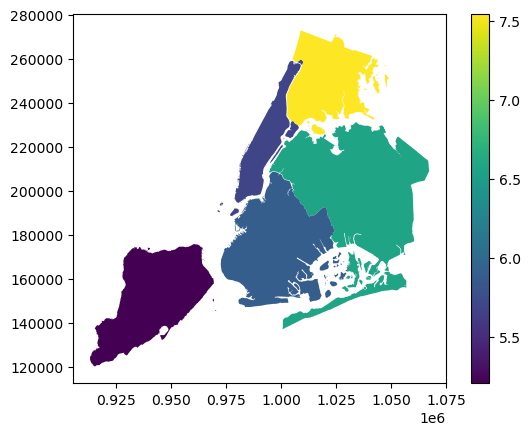

In [34]:
lbw_2016.plot("percentage",legend=True)


<Axes: >

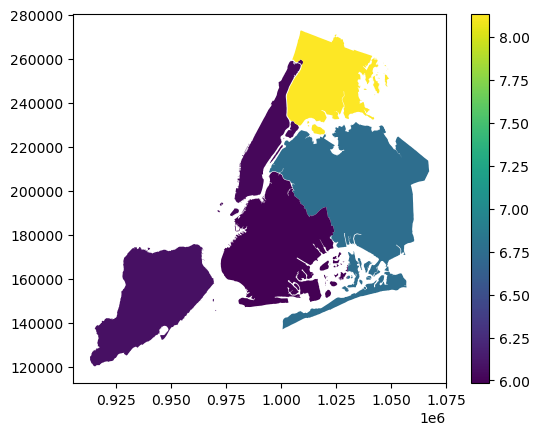

In [35]:
lbw_2017 = total_lbw_gdf[total_lbw_gdf['year']==2017]
lbw_2017.plot("percentage",legend=True)

<Axes: >

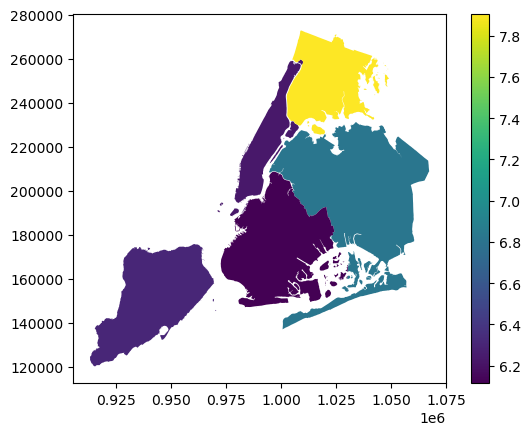

In [36]:
lbw_2018 = total_lbw_gdf[total_lbw_gdf['year']==2018]
lbw_2018.plot("percentage",legend=True)

<Axes: >

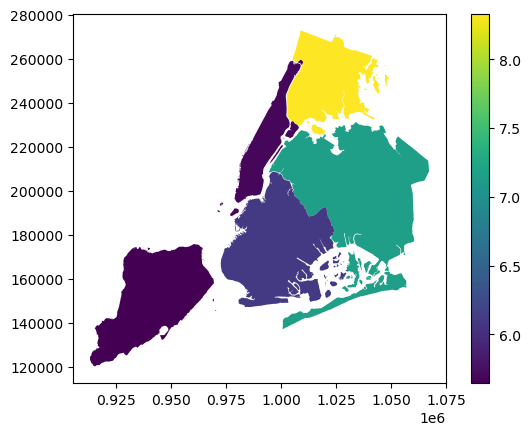

In [37]:
lbw_2019 = total_lbw_gdf[total_lbw_gdf['year']==2019]
lbw_2019.plot("percentage",legend=True)

<Axes: >

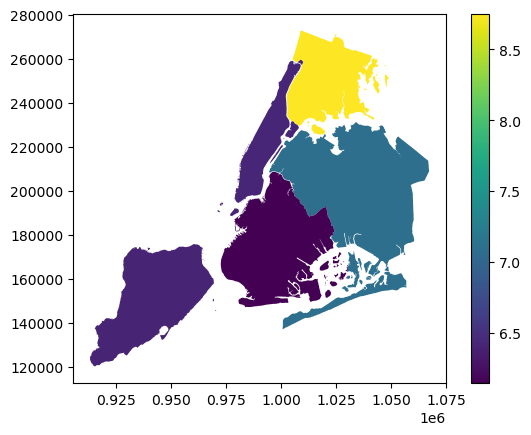

In [38]:
lbw_2020 = total_lbw_gdf[total_lbw_gdf['year']==2020]
lbw_2020.plot("percentage",legend=True)

<Axes: >

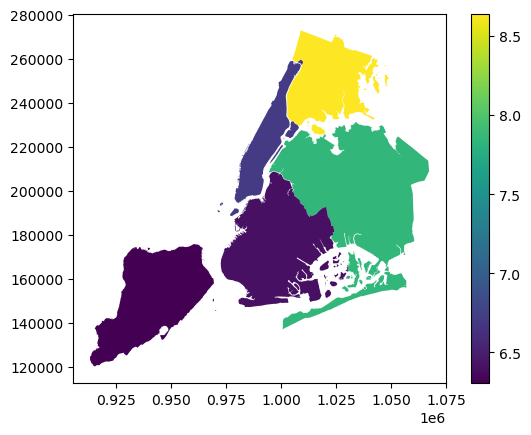

In [39]:
lbw_2021 = total_lbw_gdf[total_lbw_gdf['year']==2021]
lbw_2021.plot("percentage",legend=True)

By year

In [40]:
import folium

title = '''<h3 align="center" style="font-size:16px"><b>{}</b></h3>'''.format('Low Birth Weight Rates per year 2016-2021')

yearMap = lbw_2016.explore(
   column="percentage", # make choropleth based on "Percentage" column
   tooltip=["BoroName_x",'total births','500-2500g births','percentage'], # show "BoroName" value in tooltip (on hover) # show all values in popup (on click)
   tiles="CartoDB positron", # use "CartoDB positron" tiles
   cmap="Reds", # use "Set1" matplotlib colormap
   style_kwds=dict(color="black"), # use black outline
   scheme='natural_breaks',
   legend_kwds=dict(interval=True),
   name = '2016',
   vmin=min_total_val,
   vmax=max_total_val
)

lbw_2017.explore(
   column="percentage", # make choropleth based on "Percentage" column
   tooltip=["BoroName_x",'total births','500-2500g births','percentage'], # show "BoroName" value in tooltip (on hover) # show all values in popup (on click)
   tiles="CartoDB positron", # use "CartoDB positron" tiles
   cmap="Reds", # use "Set1" matplotlib colormap
   style_kwds=dict(color="black"), # use black outline
   scheme='natural_breaks',
   legend_kwds=dict(interval=True),
   m = yearMap,
   name = '2017',
   vmin=min_total_val,
   vmax=max_total_val
)

lbw_2018.explore(
   column="percentage", # make choropleth based on "Percentage" column
   tooltip=["BoroName_x",'total births','500-2500g births','percentage'], # show "BoroName" value in tooltip (on hover) # show all values in popup (on click)
   tiles="CartoDB positron", # use "CartoDB positron" tiles
   cmap="Reds", # use "Set1" matplotlib colormap
   style_kwds=dict(color="black"), # use black outline
   scheme='natural_breaks',
   legend_kwds=dict(interval=True),
   m = yearMap,
   name = '2018'
)
lbw_2019.explore(
   column="percentage", # make choropleth based on "Percentage" column
   tooltip=["BoroName_x",'total births','500-2500g births','percentage'], # show "BoroName" value in tooltip (on hover) # show all values in popup (on click)
   tiles="CartoDB positron", # use "CartoDB positron" tiles
   cmap="Reds", # use "Set1" matplotlib colormap
   style_kwds=dict(color="black"), # use black outline
   scheme='natural_breaks',
   legend_kwds=dict(interval=True),
   m = yearMap,
   name = '2019',
   vmin=min_total_val,
   vmax=max_total_val
)
lbw_2020.explore(
   column="percentage", # make choropleth based on "Percentage" column
   tooltip=["BoroName_x",'total births','500-2500g births','percentage'], # show "BoroName" value in tooltip (on hover) # show all values in popup (on click)
   tiles="CartoDB positron", # use "CartoDB positron" tiles
   cmap="Reds", # use "Set1" matplotlib colormap
   style_kwds=dict(color="black"), # use black outline
   scheme='natural_breaks',
   legend_kwds=dict(interval=True),
   m = yearMap,
   name = '2020',
   vmin=min_total_val,
   vmax=max_total_val
)
lbw_2021.explore(
   column="percentage", # make choropleth based on "Percentage" column
   tooltip=["BoroName_x",'total births','500-2500g births','percentage'], # show "BoroName" value in tooltip (on hover) # show all values in popup (on click)
   tiles="CartoDB positron", # use "CartoDB positron" tiles
   cmap="Reds", # use "Set1" matplotlib colormap
   style_kwds=dict(color="black"), # use black outline
   scheme='natural_breaks',
   legend_kwds=dict(interval=True),
   m = yearMap,
   name = '2021',
   vmin=min_total_val,
   vmax=max_total_val
)
folium.LayerControl().add_to(yearMap)
yearMap.get_root().html.add_child(folium.Element(title))
yearMap.save("yearMap.html")

In [41]:
lbw_2016_A = race_2016_df[race_2016_df['race']=='Asian']
lbw_2016_A.set_index('BoroCode')
lbw_2016_A

,BoroCode,BoroName_x,Shape_Leng,Shape_Area,geometry,BoroName_y,Year,race,hispanic origin,total births,500-2500g births,percentage
0,5,Staten Island,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227....","Richmond County, NY",2016,Asian,Hispanic or Latino,82,0,0.000000
1,5,Staten Island,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227....","Richmond County, NY",2016,Asian,Not Hispanic or Latino,492,23,0.000000
36,4,Queens,896344.047763,3.045213e+09,"MULTIPOLYGON (((1029606.077 156073.814, 102957...","Queens County, NY",2016,Asian,Hispanic or Latino,514,31,0.000000
37,4,Queens,896344.047763,3.045213e+09,"MULTIPOLYGON (((1029606.077 156073.814, 102957...","Queens County, NY",2016,Asian,Not Hispanic or Latino,9363,678,1.666133
72,3,Brooklyn,741080.523166,1.937479e+09,"MULTIPOLYGON (((1021176.479 151374.797, 102100...","Kings County, NY",2016,Asian,Hispanic or Latino,398,23,2.512563
73,3,Brooklyn,741080.523166,1.937479e+09,"MULTIPOLYGON (((1021176.479 151374.797, 102100...","Kings County, NY",2016,Asian,Not Hispanic or Latino,6081,379,1.578688
108,1,Manhattan,359299.096471,6.364715e+08,"MULTIPOLYGON (((981219.056 188655.316, 980940....","New York County, NY",2016,Asian,Hispanic or Latino,244,20,0.000000
109,1,Manhattan,359299.096471,6.364715e+08,"MULTIPOLYGON (((981219.056 188655.316, 980940....","New York County, NY",2016,Asian,Not Hispanic or Latino,2585,150,1.199226
144,2,Bronx,464392.991824,1.186925e+09,"MULTIPOLYGON (((1012821.806 229228.265, 101278...","Bronx County, NY",2016,Asian,Hispanic or Latino,872,71,2.637615
145,2,Bronx,464392.991824,1.186925e+09,"MULTIPOLYGON (((1012821.806 229228.265, 101278...","Bronx County, NY",2016,Asian,Not Hispanic or Latino,991,83,2.522704


In [42]:
# print(lbw_2016_A.groupby('BoroCode')['Percentage'].sum())
lbw_2016_A
# lbw_2016_A.loc[['BoroCode']].sum()
# lbw_2016_A.set_index('BoroCode')
# lbw_2016_A.groupby('BoroCode').sum(numeric_only=True)
lbw_2016_A_total=pd.read_csv('Datasets/asian_lbw_2016_total.csv')
lbw_2016_A_total=pd.merge(gdf,lbw_2016_A_total)
lbw_2016_A_total
lbw_2016_A_total['Percentage']=lbw_2016_A_total['Percentage']*100
lbw_2016_A_total.explore(
     column="Percentage", # make choropleth based on "Percentage" column
     tooltip="BoroName", # show "BoroName" value in tooltip (on hover)
     popup=True, # show all values in popup (on click)
     scheme='quantiles',
     tiles="CartoDB positron", # use "CartoDB positron" tiles
     cmap="Reds", # use "Set1" matplotlib colormap
     style_kwds=dict(color="black") # use black outline
    )

In [43]:

lbw_2016.explore(
     column="percentage", # make choropleth based on "Percentage" column
     tooltip="BoroName_x", # show "BoroName" value in tooltip (on hover)
     popup=True, # show all values in popup (on click)
     tiles="CartoDB positron", # use "CartoDB positron" tiles
     cmap="Reds", # use "Set1" matplotlib colormap
     style_kwds=dict(color="black"), # use black outline
     scheme='natural_breaks',
     legend_kwds=dict(interval=True)
    )

In [44]:
lbw_2016_AA_total=pd.read_csv('Datasets/aa_lbw_2016_total.csv')
lbw_2016_AA_total=pd.merge(gdf,lbw_2016_AA_total)
lbw_2016_AA_total['Percentage']=lbw_2016_AA_total['Percentage']*100
lbw_2016_AA_total
lbw_2016_AA_total.explore(
     column="Percentage", # make choropleth based on "Percentage" column
     tooltip="BoroName", # show "BoroName" value in tooltip (on hover)
     popup=True, # show all values in popup (on click)
     tiles="CartoDB positron", # use "CartoDB positron" tiles
     cmap="Reds", # use "Set1" matplotlib colormap
     style_kwds=dict(color="black") # use black outline
    )

In [45]:
lbw_2016_W_total=pd.read_csv('Datasets/white_lbw_2016_total.csv')
lbw_2016_W_total=pd.merge(gdf,lbw_2016_W_total)
lbw_2016_W_total['Percentage']=lbw_2016_W_total['Percentage']*100
lbw_2016_W_total
lbw_2016_W_total.explore(
     column="Percentage", # make choropleth based on "Percentage" column
     tooltip=['BoroName','race','total births','500-2500g births','Percentage'], # show "BoroName" value in tooltip (on hover)
     popup='BoroName',# show all values in popup (on click)
     scheme="quantiles",
     tiles="CartoDB positron", # use "CartoDB positron" tiles
     cmap="Reds", # use "Set1" matplotlib colormap
     style_kwds=dict(color="black"), # use black outline
     name = "white",
     legend = True,
     # legend_kwds={'colorbar':True, 'labels':[['Less than 0.01'],['0.01-0.015'],['0.015-0.02'],['0.02-0.025'],['0.025-0.03'],['0.03-0.035'],['>0.035']]}
)

In [46]:
lbw_2016_all = pd.read_csv('Datasets/lbw_2016_all_races.csv')
lbw_2016_all
minval = lbw_2016_all.Percentage.min()*100
maxval = lbw_2016_all.Percentage.max()*100

In [47]:
import folium


m = lbw_2016_W_total.explore(
     column="Percentage", # make choropleth based on "Percentage" column
     tooltip="BoroName", # show "BoroName" value in tooltip (on hover)
     popup=['BoroName','race','total births','500-2500g births','Percentage'], # show all values in popup (on click)
     # scheme="equal_interval",
     tiles="CartoDB positron", # use "CartoDB positron" tiles
     cmap="Reds", # use "Set1" matplotlib colormap
     vmin = minval,
     vmax = maxval,
     style_kwds=dict(color="black"), # use black outline
     name = "white",
     legend = True,
     legend_kwds={'interval':True},
     classification_kwds=dict(bins=[0,0.01,0.015,0.02,0.025,0.03,0.035])
     # legend_kwds={'colorbar':True, 'labels':[['Less than 0.01'],['0.01-0.015'],['0.015-0.02'],['0.02-0.025'],['0.025-0.03'],['0.03-0.035'],['>0.035']]}
)

lbw_2016_AA_total.explore(
     m = m,
     column="Percentage", # make choropleth based on "Percentage" column
     tooltip="BoroName", # show "BoroName" value in tooltip (on hover)
     popup=['BoroName','race','total births','500-2500g births','Percentage'], # show all values in popup (on click)
     # scheme="equal_interval",
     tiles="CartoDB positron", # use "CartoDB positron" tiles
     cmap="Reds", # use "Set1" matplotlib colormap
     vmin = minval,
     vmax = maxval,
     style_kwds=dict(color="black"), # use black outline
     name = "black or african american",
     classification_kwds=dict(bins=[0,0.01,0.015,0.02,0.025,0.03,0.035]),
     legend = False
)
lbw_2016_A_total.explore(
     m=m,
     column="Percentage", # make choropleth based on "Percentage" column
     tooltip="BoroName", # show "BoroName" value in tooltip (on hover)
     popup=['BoroName','race','total births','500-2500g births','Percentage'], # show all values in popup (on click)
     # scheme="equal_interval",
     tiles="CartoDB positron", # use "CartoDB positron" tiles
     cmap="Reds", # use "Set1" matplotlib colormap
     vmin=minval,
     vmax=maxval,
     name="asian",
     legend=False,
     style_kwds=dict(color="black") # use black outline
    )
folium.LayerControl().add_to(m)
m

In [48]:
payment = pd.read_csv('Datasets/source_of_payment_grouped_by_race.csv')
payment=pd.merge(gdf,payment,on='BoroCode')
payment_2016 = payment[payment['Year']==2016]
payment_2016_medicaid = payment_2016[payment_2016['Source of Payment for Delivery']=='Medicaid']
payment_2016_medicaid.explore(
   column = 'Births',
   tiles="CartoDB positron", # use "CartoDB positron" tiles
   cmap="Reds",
   legend_kwds=dict(interval=True),
   style_kwds=dict(color="black")
)

In [49]:

payment_2016_medicaid_A = payment_2016_medicaid[payment_2016_medicaid['Mother\'s Single Race 6']=='Asian']
payment_2016_medicaid_A.explore(
   column = 'Births',
   tiles="CartoDB positron", # use "CartoDB positron" tiles
   cmap="Reds",
   legend_kwds=dict(interval=True),
   scheme = 'equal_interval',
   style_kwds=dict(color="black")
)

In [50]:
# %conda install -c conda-forge dash
from dash import Dash, dcc, html, Input, Output
import plotly.express as px

In [53]:
total_allyears_lbw_df = pd.read_csv('Datasets/total_lbw_race_allyears.csv')
total_allyears_lbw_gdf = pd.merge(gdf,total_allyears_lbw_df,on='BoroCode')
total_allyears_lbw_gdf['percentage']=total_allyears_lbw_gdf['percentage']*100
total_allyears_lbw_gdf

,BoroCode,BoroName_x,Shape_Leng,Shape_Area,geometry,BoroName_y,race,500-2500g births,total births,percentage
0,5,Staten Island,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227....",Staten Island,Asian,215,3742,5.745591
1,5,Staten Island,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227....",Staten Island,Black or African American,441,4412,9.995467
2,5,Staten Island,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227....",Staten Island,White,992,19744,5.024311
3,4,Queens,896344.047763,3.045213e+09,"MULTIPOLYGON (((1029606.077 156073.814, 102957...",Queens,Asian,3906,49674,7.863268
4,4,Queens,896344.047763,3.045213e+09,"MULTIPOLYGON (((1029606.077 156073.814, 102957...",Queens,Black or African American,2892,29692,9.739997
5,4,Queens,896344.047763,3.045213e+09,"MULTIPOLYGON (((1029606.077 156073.814, 102957...",Queens,White,3702,70897,5.221660
6,3,Brooklyn,741080.523166,1.937479e+09,"MULTIPOLYGON (((1021176.479 151374.797, 102100...",Brooklyn,Asian,1923,29806,6.451721
7,3,Brooklyn,741080.523166,1.937479e+09,"MULTIPOLYGON (((1021176.479 151374.797, 102100...",Brooklyn,Black or African American,5107,51667,9.884452
8,3,Brooklyn,741080.523166,1.937479e+09,"MULTIPOLYGON (((1021176.479 151374.797, 102100...",Brooklyn,White,5177,119992,4.314454
9,1,Manhattan,359299.096471,6.364715e+08,"MULTIPOLYGON (((981219.056 188655.316, 980940....",Manhattan,Asian,852,13932,6.115418


In [55]:
allyears_a = total_allyears_lbw_gdf[total_allyears_lbw_gdf['race']=='Asian']

# aa
allyears_aa = total_allyears_lbw_gdf[total_allyears_lbw_gdf['race']=='Black or African American']

# white
allyears_w = total_allyears_lbw_gdf[total_allyears_lbw_gdf['race']=='White']



,BoroCode,BoroName_x,Shape_Leng,Shape_Area,geometry,BoroName_y,race,500-2500g births,total births,percentage
0,5,Staten Island,330470.010332,1.623820e+09,"MULTIPOLYGON (((970217.022 145643.332, 970227....",Staten Island,Asian,215,3742,5.745591
3,4,Queens,896344.047763,3.045213e+09,"MULTIPOLYGON (((1029606.077 156073.814, 102957...",Queens,Asian,3906,49674,7.863268
6,3,Brooklyn,741080.523166,1.937479e+09,"MULTIPOLYGON (((1021176.479 151374.797, 102100...",Brooklyn,Asian,1923,29806,6.451721
9,1,Manhattan,359299.096471,6.364715e+08,"MULTIPOLYGON (((981219.056 188655.316, 980940....",Manhattan,Asian,852,13932,6.115418
12,2,Bronx,464392.991824,1.186925e+09,"MULTIPOLYGON (((1012821.806 229228.265, 101278...",Bronx,Asian,708,7775,9.106109
